## E19 프로젝트: SRGAN 활용하기

### 프로젝트 1: 직접 고른 이미지로 SRGAN 실험하기

In [6]:
import tensorflow_datasets as tfds
tfds.load("div2k/bicubic_x4")

{'train': <PrefetchDataset shapes: {hr: (None, None, 3), lr: (None, None, 3)}, types: {hr: tf.uint8, lr: tf.uint8}>,
 'validation': <PrefetchDataset shapes: {hr: (None, None, 3), lr: (None, None, 3)}, types: {hr: tf.uint8, lr: tf.uint8}>}

### 프로젝트 1-1.

(1080, 1920, 3)


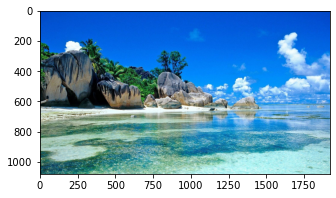

In [10]:
import matplotlib.pyplot as plt
from skimage import io
img = io.imread('/home/aiffel/aiffel/super_resolution/hrimg.jpg')

print (img.shape)

plt.figure(figsize = (6, 3))
plt.imshow(img)

(270, 480, 3)


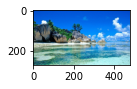

In [12]:
import cv2
lr_image = cv2.resize(img, dsize=(480, 270))

print(lr_image.shape)
plt.figure(figsize = (3, 1))
plt.imshow(lr_image)

In [7]:
import tensorflow as tf
import os
import numpy as np

model_file = os.getenv('HOME')+'/aiffel/super_resolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

In [13]:
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

train, valid = tfds.load(
    "div2k/bicubic_x4", 
    split=["train","validation"],
    as_supervised=True
)

for i, (lr, hr) in enumerate(valid):
    if i == 6: break

srgan_hr = apply_srgan(lr_image)
print("✅")

✅


In [8]:
bicubic_image = cv2.resize(
    lr_image, 
    dsize=(1920, 1080), # (가로 픽셀 수, 세로 픽셀 수)
    interpolation=cv2.INTER_CUBIC # bicubic interpolation 적용
)

In [9]:
print(img.shape)
print(bicubic_image.shape)
print(srgan_hr.shape)

(1080, 1920, 3)
(1080, 1920, 3)
(1080, 1920, 3)


/home/aiffel/anaconda3/envs/aiffel/lib/python3.7/site-packages/skimage/metrics/simple_metrics.py:160: RuntimeWarning: divide by zero encountered in double_scalars
  return 10 * np.log10((data_range ** 2) / err)


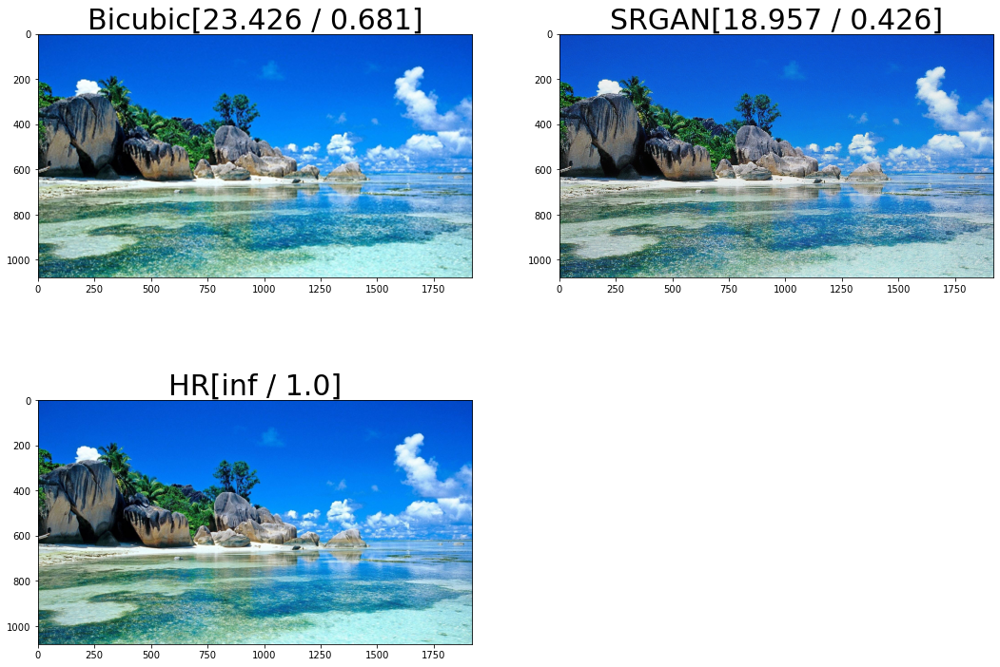

In [10]:
from skimage.metrics import peak_signal_noise_ratio, structural_similarity

images = [bicubic_image, srgan_hr, img]
titles = [ "Bicubic", "SRGAN", "HR"]

psnr = [round(peak_signal_noise_ratio(img, i), 3) for i in images]
sslm = [round(structural_similarity(img, i, multichannel=True), 3) for i in images]

plt.figure(figsize=(18, 13))
for i in range(3):
    plt.subplot(2, 2, i+1)
    plt.imshow(images[i])
    plt.title(titles[i] + f"[{psnr[i]} / {sslm[i]}]", fontsize = 30)

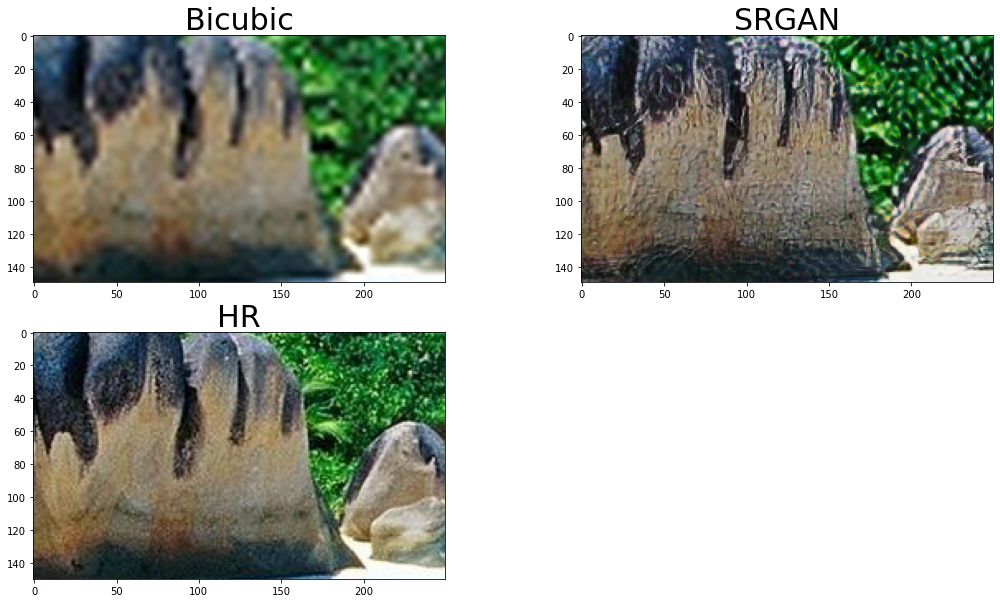

In [12]:
def crop(image, left_top, x = 200, y = 200):
    return image[left_top[0]:(left_top[0] + x), left_top[1]:(left_top[1] + y), :]

left_top = (500, 500)
crop_images = [crop(i, left_top, 150, 250) for i in images]

plt.figure(figsize=(18, 10))

for i in range(3):
    plt.subplot(2, 2, i+1)
    plt.imshow(crop_images[i])
    plt.title(titles[i], fontsize=30)

- psnr, sslm 수치상으로는 의외로 Bicubic의 결과가 높게 나왔습니다. (예제 등에서는 bicubic의 결과가 좋지 않음)
- 그러나 육안으로 보았을 때는 분명 SRGAN이 더 선명하게 보이는데, 원본과는 조금 다른 왜곡을 보이고 있어 (바위의 주름이 더 깊어 보입니다), 이런 것들이 수치상 영향을 주지 않았을까하고 의심됩니다. DIV2K가 학습한 데이타와 달라 성능이 만족스럽지 못할 가능성도 있어 보입니다.

### 프로젝트 1-2.

(368, 552, 3)


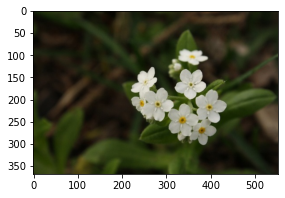

In [13]:
lr_img = io.imread('/home/aiffel/aiffel/super_resolution/lrimg.jpg')
print (lr_img.shape)

plt.figure(figsize = (6, 3))
plt.imshow(lr_img)

In [14]:
srgan_hr = apply_srgan(lr_img)

In [15]:
bicubic_image = cv2.resize(
    lr_img, 
    dsize=(2208, 1472), # (가로 픽셀 수, 세로 픽셀 수)
    interpolation=cv2.INTER_CUBIC # bicubic interpolation 적용
)

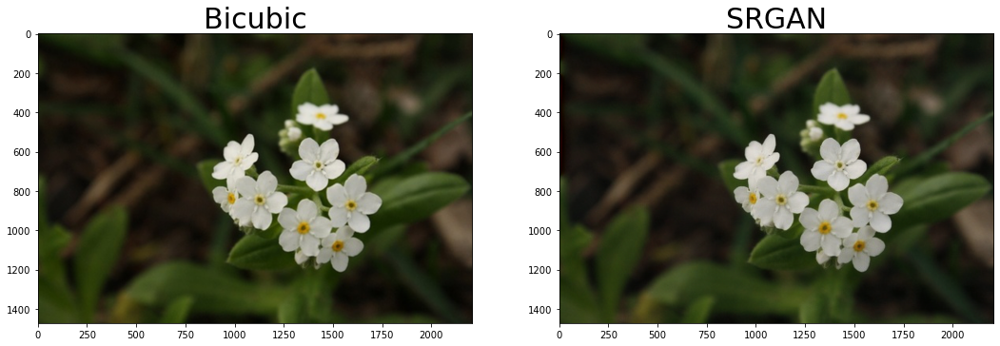

In [16]:
images = [bicubic_image, srgan_hr]
titles = [ "Bicubic", "SRGAN"]

plt.figure(figsize=(18, 13))
for i in range(2):
    plt.subplot(2, 2, i+1)
    plt.imshow(images[i])
    plt.title(titles[i], fontsize = 30)

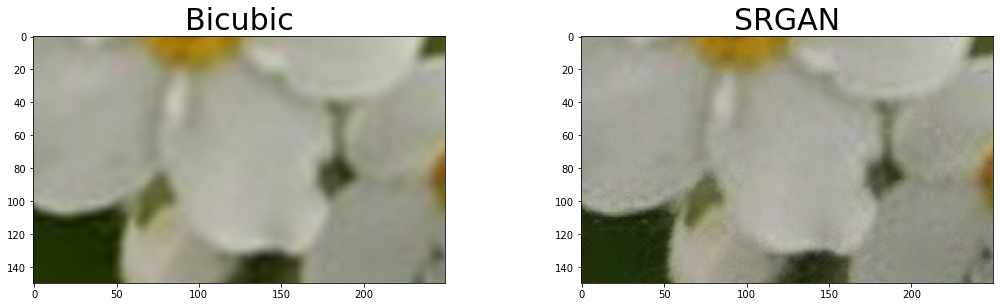

In [17]:
def crop(image, left_top, x = 200, y = 200):
    return image[left_top[0]:(left_top[0] + x), left_top[1]:(left_top[1] + y), :]

left_top = (1000, 1250)
crop_images = [crop(i, left_top, 150, 250) for i in images]

plt.figure(figsize=(18, 10))

for i in range(2):
    plt.subplot(2, 2, i+1)
    plt.imshow(crop_images[i])
    plt.title(titles[i], fontsize=30)

- 육안으로 보았을 때, 거의 차이가 없어 보입니다. 오히려 SRGAN의 이미지가 노이즈가 많아 보입니다.
- DIV2K의 학습데이타와 잘맞지 않는는 이미지인 것으로 보입니다.

### 프로젝트 2: SRGAN을 이용해 고해상도 gif 생성하기

#### 1. gif파일 불러오기

In [1]:
import cv2

gif = cv2.VideoCapture("/home/aiffel/aiffel/super_resolution/city_night_lr.gif")

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)
    
print("frames 수: ", len(frames))
print("frame 크기: ", (frames[0].shape))

frames 수:  8
frame 크기:  (255, 500, 3)


#### 2. 프레임별 Super Resolution 진행하기

In [14]:
frames_sr = []

for i in range(8):
    if i % 2 == 0:
        frames_sr.append(apply_srgan(frames[i]))


In [15]:
frames_bc = []

for i in range(8):
    if i % 2 == 0:
        frames_bc.append(cv2.resize(frames[i], dsize =(2000, 1020),
                               interpolation=cv2.INTER_CUBIC))


#### 3. 프레임을 합처 gif 만들기

In [16]:
import imageio

imageio.mimsave("/home/aiffel/aiffel/super_resolution/citynight_srgan.gif", frames_sr)
imageio.mimsave("/home/aiffel/aiffel/super_resolution/citynight_bicubic.gif", frames_bc)


#### 4. Jupyter Notebook에 gif 표시하기

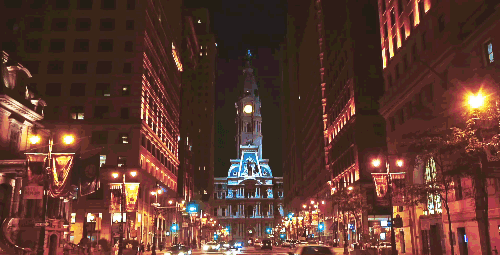

In [18]:
from IPython.display import Image as show_gif

show_gif("/home/aiffel/aiffel/super_resolution/city_night_lr.gif", width = 800)

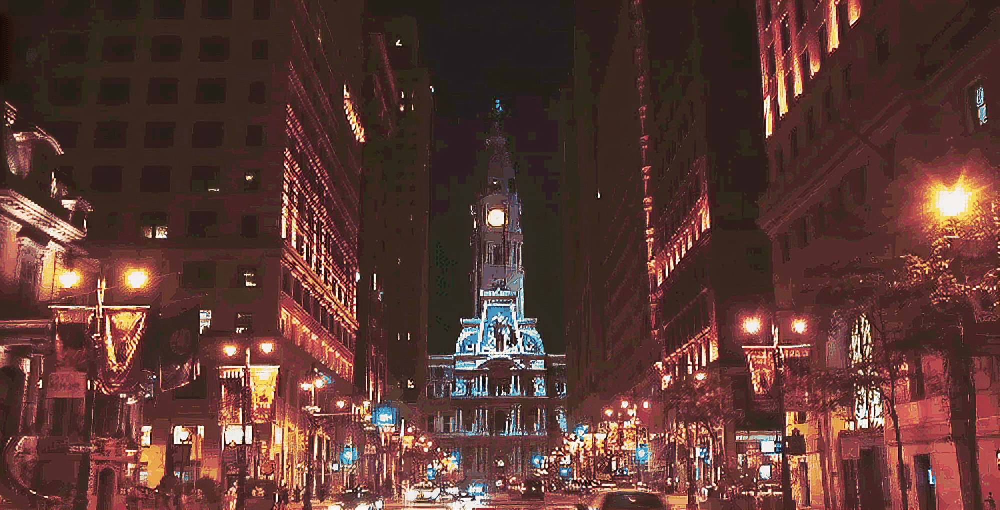

In [19]:
show_gif("/home/aiffel/aiffel/super_resolution/citynight_srgan.gif", width = 800)

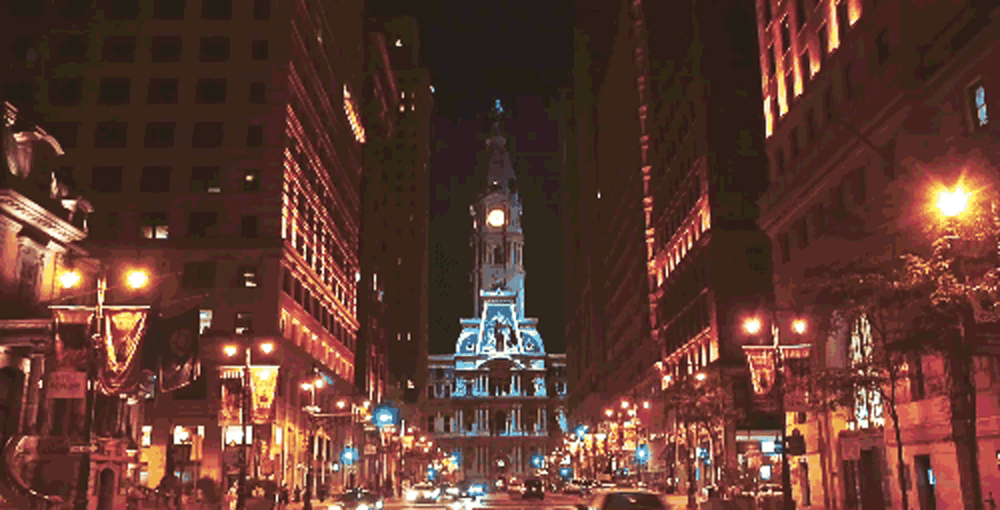

In [20]:
show_gif("/home/aiffel/aiffel/super_resolution/citynight_bicubic.gif", width = 800)

- SRGAN을 적용한 이미지들을 생성했습니다.
- 이미지들의 특성과 super resolution 방법을 관련지어 나름대로의 방식으로 분석하였습니다.
- 저해상도 원본 gif와 고해상도 gif의 차이가 시각적으로 확인 가능합니다.
- github에 올리기 위해 srgan과 bicubic gif파일들은 frame을 4개만 추가하여 파일 사이즈를 줄였습니다.